## Exploring MODIS Data for Frontal Eddies

* Download a bunch of chl-a and SST data from MODIS, I guess level 3 is good enough but need to double check
    * should also download some GOES SST data and think about altimetry data
    * also need bathymetry dataset for masking to outer shelf
*  Sum up the monthly chla 
    * what are the hotspots across the Atlantic Ocean and SAB region?
*  Transect out to the sargasso sea on x and on the y show chl-a across time
    * also do this with SST
* Explore chl-a images for the chl-a fronts 
    * make a front frequency map based on the sharpest gradient
* Explore frontal eddies in SST, chl-a, and altimetry 
    * probably need level 2 for this or even level 2 and not cloud masking
    * Need to get an idea for whether the productivity is generally inside or outside of the frontal eddy
    * Key to remember that if the eddy exists in a gradient (which 99% it does) that it will stir that gradient and produce anomalies just via stirring like the typical dipole seen in eddies
    *  Should definitely look into eddy centric coordinates for frontal eddies
    *  Put together a time series of an eddy from GOES SST data and maybe from the RGB bands
* Run an EOF analysis on the whole area to get a better idea for spatial patterns
* What dominates variability of phytoplankton production and diversity in the South Atlantic Bight north of the Charleston Bump to Cape Hatteras? Assuming it is frontal eddies or other GS driven upwelling. How much of this is on the submesoscale?
    *  It could also be wind, seasonality, hurricanes, etc.
    *  How far offshore do I need to go to avoid terrestrial inputs being significant?
    *  Also just quantifying the basic spatial and temporal variability as in Doney et al 2003 and showing which regions have the highest variability using semi-variograms and std dev.
*  Do a scaling analysis in this area and it will be much more informative once I have a general idea of what dominates variability.
    *  Which I might be able to understand just from papers, but also want to demonstrate.
    *  This scaling analysis could also be from a single point and I could see if the variability is roughly biweekly and seasonal as would be expected from frontal eddies and phenology.
*  How many frontal eddies actually occur?
*  Have any BGC-Argo floats been entrained in a frontal eddy?

In [1]:
import numpy as np
import xarray as xr
import os.path as op
from matplotlib import colors, ticker
import matplotlib.pyplot as plt
%matplotlib inline

from datetime import date, timedelta, datetime
import cartopy.crs as crs
import hvplot.xarray

#### Download Data from OpenDAP

In [87]:
# example full url is 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2003/103/A2003103.L3m_DAY_CHL_chlor_a_4km.nc'

base_url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/'

start_date = date(2018, 7, 1)
current_date = date(2018, 7, 1)
end_date = date(2018, 7, 30)
delta = timedelta(days=1)

while current_date <= end_date:
    url = base_url + current_date.strftime("%Y") + "/" + current_date.strftime("%j") + "/A" + \
    current_date.strftime("%Y") + current_date.strftime("%j") + ".L3m_DAY_CHL_chlor_a_4km.nc"
    
    
    ds = xr.open_dataset(url)
    ds_geo_subset = ds.sel( lat=slice(42, 20), lon=slice(-85,-65))
    print(ds_geo_subset.chlor_a.size)
    expanded_ds = ds_geo_subset.expand_dims("time").assign_coords(time=("time", [np.datetime64(current_date)]))
    if current_date == start_date:
        expanded_ds.to_zarr('chla_zarr_summer')
    else:
        expanded_ds.to_zarr('chla_zarr_summer', append_dim='time')
    print('finished: ', url)
    current_date += delta

253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/182/A2018182.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/183/A2018183.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/184/A2018184.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/185/A2018185.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/186/A2018186.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/187/A2018187.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/188/A2018188.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/189/A2018189.L3m_DAY_CHL_chlor_a

In [99]:
# example full url is 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2003/103/A2003103.L3m_DAY_CHL_chlor_a_4km.nc'

base_url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/'

start_date = date(2018, 1, 1)
current_date = date(2018, 1, 1)
end_date = date(2018, 12, 25)
delta = timedelta(days=8)

while current_date <= end_date:
    end_period = current_date + timedelta(days=7)
    
    url = base_url + current_date.strftime("%Y") + "/" + current_date.strftime("%j") + "/A" + \
    current_date.strftime("%Y") + current_date.strftime("%j") + end_period.strftime("%Y") + \
    end_period.strftime("%j") + ".L3m_8D_CHL_chlor_a_4km.nc"
    
    
    ds = xr.open_dataset(url)
    ds_geo_subset = ds.sel( lat=slice(42, 20), lon=slice(-85,-65))
    print(ds_geo_subset.chlor_a.size)
    expanded_ds = ds_geo_subset.expand_dims("time").assign_coords(time=("time", [np.datetime64(current_date)]))
    if current_date == start_date:
        expanded_ds.to_zarr('chla_zarr_8D')
    else:
        expanded_ds.to_zarr('chla_zarr_8D', append_dim='time')
    print('finished: ', url)
    current_date += delta

253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/001/A20180012018008.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/009/A20180092018016.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/017/A20180172018024.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/025/A20180252018032.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/033/A20180332018040.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/041/A20180412018048.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/049/A20180492018056.L3m_8D_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L

OSError: [Errno -90] NetCDF: file not found: b'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2018/361/A20183612019003.L3m_8D_CHL_chlor_a_4km.nc'

#### Open the Data

In [100]:
chla_ds = xr.open_zarr('chla_zarr_8D')

In [101]:
proj = crs.Orthographic(-90, 30)

chla_ds.chlor_a.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=True, clim=(0.01,2), datashade=True)

:DynamicMap   [time]
   :Overlay
      .RGB.I       :RGB   [lon,lat]   (R,G,B,A)
      .Coastline.I :Feature   [Longitude,Latitude]

### Subset to area from Charleston to Cape Hatteras and find examples that are >70% nonnan

In [ ]:
np.count_nonzero(~np.isnan(data))

### Calculate Monthly Averages and then sum up chl-a through time ignoring nans

In [103]:
chla_ds_month = chla_ds.resample(time='1M').mean()

In [106]:
proj = crs.Orthographic(-90, 30)

chla_ds_month.chlor_a.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=True, clim=(0.01,2), datashade=True)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


:DynamicMap   [time]
   :Overlay
      .RGB.I       :RGB   [lon,lat]   (R,G,B,A)
      .Coastline.I :Feature   [Longitude,Latitude]

In [114]:
chla_ds_month.chlor_a.sum(dim='time', skipna=False).hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=True, clim=(0.01,20), datashade=True)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


:DynamicMap   []
   :Overlay
      .RGB.I       :RGB   [lon,lat]   (R,G,B,A)
      .Coastline.I :Feature   [Longitude,Latitude]

### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

In [183]:
chla_lat_subset = chla_ds_month.sel(lat=slice(35,34.9))

chla_lat_subset.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, frame_height=300, logz=True, clim=(0.01,20), datashade=False)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


:DynamicMap   [time]
   :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chlor_a)
      .Coastline.I :Feature   [Longitude,Latitude]

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  """


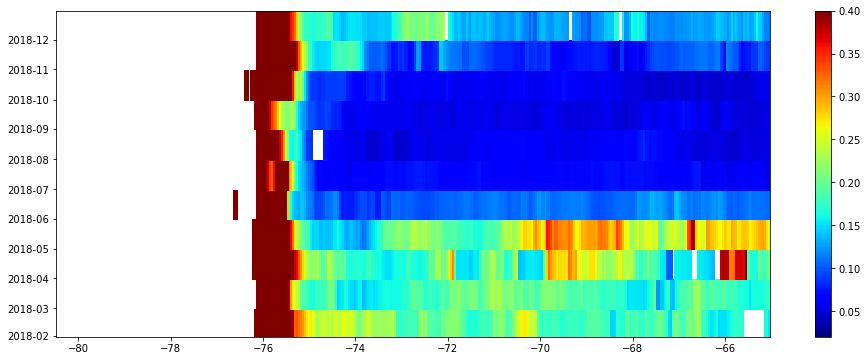

In [184]:
### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

chla_lat_mean = chla_lat_subset.mean(dim='lat', skipna=True).sel(lon=slice(-80.5,-64))
fig,ax = plt.subplots(figsize=(16,6))
im = ax.pcolor(chla_lat_mean.lon, chla_lat_mean.time, chla_lat_mean.chlor_a, vmax=0.4, vmin=0.02, cmap='jet')
fig.colorbar(im)

In [175]:
### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

chla_lat_subset = chla_ds_month.sel(lat=slice(34.5,34.3))

chla_lat_subset.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, frame_height=300, logz=True, clim=(0.01,20), datashade=False)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


:DynamicMap   [time]
   :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chlor_a)
      .Coastline.I :Feature   [Longitude,Latitude]

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  """


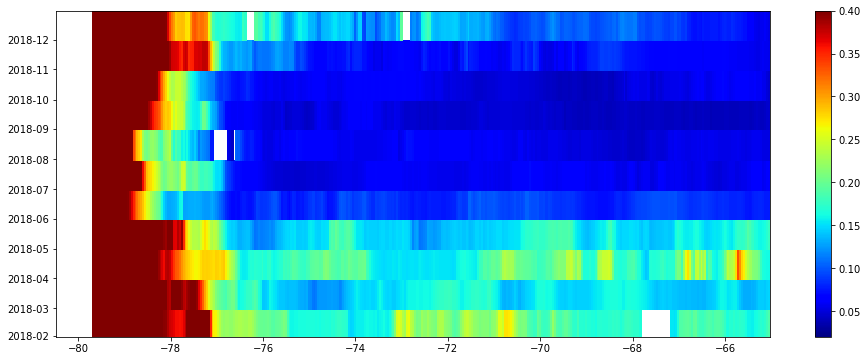

In [181]:
### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

chla_lat_mean = chla_lat_subset.mean(dim='lat', skipna=True).sel(lon=slice(-80.5,-64))
fig,ax = plt.subplots(figsize=(16,6))
im = ax.pcolor(chla_lat_mean.lon, chla_lat_mean.time, chla_lat_mean.chlor_a, vmax=0.4, vmin=0.02, cmap='jet')
fig.colorbar(im)

In [178]:
### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

chla_lat_subset = chla_ds_month.sel(lat=slice(33,32.8))

chla_lat_subset.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, frame_height=300, logz=True, clim=(0.01,20), datashade=False)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


:DynamicMap   [time]
   :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chlor_a)
      .Coastline.I :Feature   [Longitude,Latitude]

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/dask/array/numpy_compat.py:41: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  """


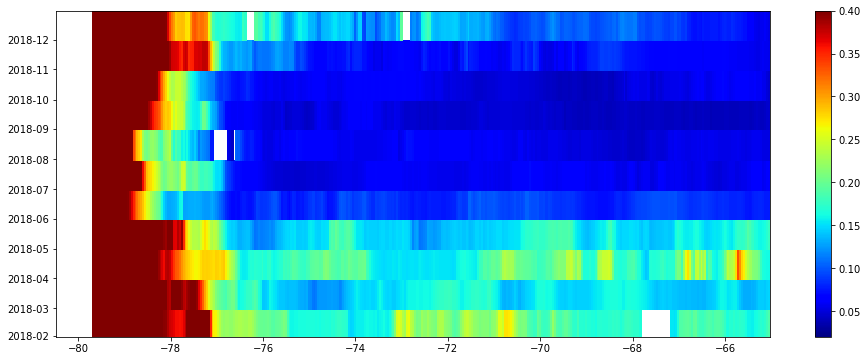

In [179]:
### Run a couple transects out across the ocean off the coastline and plot x as longitude and y as chla

chla_lat_mean = chla_lat_subset.mean(dim='lat', skipna=True).sel(lon=slice(-80.5,-64))
fig,ax = plt.subplots(figsize=(16,6))
im = ax.pcolor(chla_lat_mean.lon, chla_lat_mean.time, chla_lat_mean.chlor_a, vmax=0.4, vmin=0.02, cmap='jet')
fig.colorbar(im)

### Examine a specific frontal eddy

In [ ]:
https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/074/A2013074.L3m_DAY_CHL_chlor_a_4km.nc

In [185]:
# example full url is 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2003/103/A2003103.L3m_DAY_CHL_chlor_a_4km.nc'
                       
base_url = 'https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/'

start_date = date(2013, 3, 5)
current_date = date(2013, 3, 5)
end_date = date(2013, 3, 22)
delta = timedelta(days=1)

while current_date <= end_date:
    url = base_url + current_date.strftime("%Y") + "/" + current_date.strftime("%j") + "/A" + \
    current_date.strftime("%Y") + current_date.strftime("%j") + ".L3m_DAY_CHL_chlor_a_4km.nc"
    
    
    ds = xr.open_dataset(url)
    ds_geo_subset = ds.sel( lat=slice(42, 20), lon=slice(-85,-65))
    print(ds_geo_subset.chlor_a.size)
    expanded_ds = ds_geo_subset.expand_dims("time").assign_coords(time=("time", [np.datetime64(current_date)]))
    if current_date == start_date:
        expanded_ds.to_zarr('chla_zarr_freddy')
    else:
        expanded_ds.to_zarr('chla_zarr_freddy', append_dim='time')
    print('finished: ', url)
    current_date += delta

253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/064/A2013064.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/065/A2013065.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/066/A2013066.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/067/A2013067.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/068/A2013068.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/069/A2013069.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/070/A2013070.L3m_DAY_CHL_chlor_a_4km.nc
253440
finished:  https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/071/A2013071.L3m_DAY_CHL_chlor_a

'0305'

In [54]:
# example full url is 'https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2013/064/AQUA_MODIS.20130305.L3m.DAY.SST.sst.4km.nc'

base_url = 'https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/'

start_date = date(2019, 1, 1)
current_date = date(2019, 1, 1)
end_date = date(2019, 6, 30)
delta = timedelta(days=1)
continuing = False

while current_date <= end_date:
    url = base_url + current_date.strftime("%Y") + "/" + current_date.strftime("%j") + "/AQUA_MODIS." + \
    current_date.strftime("%Y") + current_date.strftime("%m%d") + ".L3m.DAY.SST.sst.4km.nc"
    
    
    ds = xr.open_dataset(url)
    ds_geo_subset = ds.sel( lat=slice(42, 20), lon=slice(-85,-65))
    print(ds_geo_subset.sst.size)
    expanded_ds = ds_geo_subset.expand_dims("time").assign_coords(time=("time", [np.datetime64(current_date)]))
    if current_date == start_date and not continuing:
        expanded_ds.to_zarr('chla_zarr_sst_2019')
    else:
        expanded_ds.to_zarr('chla_zarr_sst_2019', append_dim='time')
    print('finished: ', url)
    current_date += delta

253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/001/AQUA_MODIS.20190101.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/002/AQUA_MODIS.20190102.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/003/AQUA_MODIS.20190103.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/004/AQUA_MODIS.20190104.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/005/AQUA_MODIS.20190105.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/006/AQUA_MODIS.20190106.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.n

253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/053/AQUA_MODIS.20190222.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/054/AQUA_MODIS.20190223.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/055/AQUA_MODIS.20190224.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/056/AQUA_MODIS.20190225.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/057/AQUA_MODIS.20190226.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/058/AQUA_MODIS.20190227.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.n

253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/105/AQUA_MODIS.20190415.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/106/AQUA_MODIS.20190416.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/107/AQUA_MODIS.20190417.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/108/AQUA_MODIS.20190418.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/109/AQUA_MODIS.20190419.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/110/AQUA_MODIS.20190420.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.n

253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/157/AQUA_MODIS.20190606.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/158/AQUA_MODIS.20190607.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/159/AQUA_MODIS.20190608.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/160/AQUA_MODIS.20190609.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/161/AQUA_MODIS.20190610.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.nasa.gov/opendap/allData/modis/L3/aqua/11um/v2019.0/4km/daily/2019/162/AQUA_MODIS.20190611.L3m.DAY.SST.sst.4km.nc
253440
finished:  https://podaac-opendap.jpl.n

In [5]:
chla_ds = xr.open_zarr('chla_zarr_freddy')

In [6]:
proj = crs.Orthographic(-90, 30)

chla_ds.chlor_a.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=True, clim=(0.01,2))

:DynamicMap   [time]
   :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (chlor_a)
      .Coastline.I :Feature   [Longitude,Latitude]

In [3]:
sst_ds = xr.open_zarr('chla_zarr_freddy_sst')

In [7]:
proj = crs.Orthographic(-90, 30)

sst_ds.sst.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=False, clim=(21,26.5), datashade=False)

:DynamicMap   [time]
   :Overlay
      .QuadMesh.I  :QuadMesh   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]

In [203]:
ds_547 = xr.open_dataset('https://oceandata.sci.gsfc.nasa.gov/opendap/hyrax/MODISA/L3SMI/2013/074/A2013074.L3m_DAY_RRS_Rrs_547_9km.nc')
ds_547 = ds_547.sel( lat=slice(42, 20), lon=slice(-85,-65))

In [204]:
ds_547

<xarray.Dataset>
Dimensions:  (eightbitcolor: 256, lat: 264, lon: 240, rgb: 3)
Coordinates:
  * lat      (lat) float32 41.958332 41.874996 41.791664 ... 20.124998 20.041662
  * lon      (lon) float32 -84.958336 -84.875 -84.791664 ... -65.125 -65.041664
Dimensions without coordinates: eightbitcolor, rgb
Data variables:
    palette  (rgb, eightbitcolor) int8 ...
    Rrs_547  (lat, lon) float32 ...
Attributes:
    _NCProperties:                     version=1|netcdflibversion=4.4.1.1|hdf...
    product_name:                      A2013074.L3m_DAY_RRS_Rrs_547_9km.nc
    instrument:                        MODIS
    title:                             HMODISA Level-3 Standard Mapped Image
    project:                           Ocean Biology Processing Group (NASA/G...
    platform:                          Aqua
    temporal_range:                    day
    processing_version:                2018.0
    date_created:                      2017-12-31T20:40:28.000Z
    history:                           l3mapgen par=A2013074.L3m_DAY_RRS_Rrs_...
    l2_flag_names:                     ATMFAIL,LAND,HILT,HISATZEN,STRAYLIGHT,...
    time_coverage_start:               2013-03-15T00:05:01.000Z
    time_coverage_end:                 2013-03-16T02:45:00.000Z
    start_orbit_number:                57781
    end_orbit_number:                  57797
    map_projection:                    Equidistant Cylindrical
    latitude_units:                    degrees_north
    longitude_units:                   degrees_east
    northernmost_latitude:             90.0
    southernmost_latitude:             -90.0
    westernmost_longitude:             -180.0
    easternmost_longitude:             180.0
    geospatial_lat_max:                90.0
    geospatial_lat_min:                -90.0
    geospatial_lon_max:                180.0
    geospatial_lon_min:                -180.0
    grid_mapping_name:                 latitude_longitude
    latitude_step:                     0.083333336
    longitude_step:                    0.083333336
    sw_point_latitude:                 -89.958336
    sw_point_longitude:                -179.95833
    geospatial_lon_resolution:         9.276625
    geospatial_lat_resolution:         9.276625
    geospatial_lat_units:              degrees_north
    geospatial_lon_units:              degrees_east
    spatialResolution:                 9.28 km
    number_of_lines:                   2160
    number_of_columns:                 4320
    measure:                           Mean
    suggested_image_scaling_minimum:   0.0
    suggested_image_scaling_maximum:   0.015
    suggested_image_scaling_type:      LINEAR
    suggested_image_scaling_applied:   No
    _lastModified:                     2017-12-31T20:40:28.000Z
    Conventions:                       CF-1.6 ACDD-1.3
    institution:                       NASA Goddard Space Flight Center, Ocea...
    standard_name_vocabulary:          CF Standard Name Table v36
    naming_authority:                  gov.nasa.gsfc.sci.oceandata
    id:                                A2013074.L3b_DAY_RRS.nc/L3/A2013074.L3...
    license:                           http://science.nasa.gov/earth-science/...
    creator_name:                      NASA/GSFC/OBPG
    publisher_name:                    NASA/GSFC/OBPG
    creator_email:                     data@oceancolor.gsfc.nasa.gov
    publisher_email:                   data@oceancolor.gsfc.nasa.gov
    creator_url:                       http://oceandata.sci.gsfc.nasa.gov
    publisher_url:                     http://oceandata.sci.gsfc.nasa.gov
    processing_level:                  L3 Mapped
    cdm_data_type:                     grid
    identifier_product_doi_authority:  http://dx.doi.org
    identifier_product_doi:            10.5067/AQUA/MODIS/L3M/RRS/2018
    keywords:                          Earth Science > Oceans > Ocean Optics ...
    keywords_vocabulary:               NASA Global Change Master Directory (G...
    data_bins:                       

In [215]:
proj = crs.Orthographic(-90, 30)

ds_547.Rrs_547.hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='jet', dynamic=True, coastline=True, 
    frame_width=500, logz=True, clim=(0.0001,.01),)

:Overlay
   .QuadMesh.I  :QuadMesh   [lon,lat]   (Rrs_547)
   .Coastline.I :Feature   [Longitude,Latitude]

In [2]:
import gcsfs
import xarray as xr
gcsmap = gcsfs.mapping.GCSMap('pangeo-data/dataset-duacs-rep-global-merged-allsat-phy-l4-v3-alt')
ds = xr.open_zarr(gcsmap)
ds

ValueError: group not found at path ''

In [6]:
import rasterio
with rasterio.open("ecostress_data/ecostress_data/output/ECOSTRESS_L2_LSTE_12773_006_20201006T163238_0601_01_LST_UTM.tif") as dataset:
    print(dataset.meta)
    freddy_eco = dataset.read()

{'driver': 'GTiff', 'dtype': 'float64', 'nodata': 0.0, 'width': 8014, 'height': 7897, 'count': 1, 'crs': CRS.from_epsg(32618), 'transform': Affine(69.99903541810656, 0.0, 263890.41785641754,
       0.0, -69.99903541810656, 4120376.687120212)}


(array([3.2856577e+07, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 2.2790000e+03,
        2.4050000e+03, 3.0800000e+03, 4.6490000e+03, 6.8830000e+03,
        9.4010000e+03, 1.3361000e+04, 1.9026000e+04, 2.6918000e+04,
        3.7823000e+04, 5.5646000e+04, 8.0457000e+04, 1.1630500e+05,
        1.5736800e+05, 2.0241000e+05, 2.8630400e+05, 4.3203900e+05,
        3.1158280e+06, 2.5215966e+07, 6.4180000e+05, 3.0000000e+01,
        0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 3.0000000e+00]),
 array([  0.  ,   8.87,  17.74,  26.61,  35.48,  44.35,  53.22,  62.09,
         70.96,  79.83,  88.7 ,  97.57, 106.44, 115.31, 124.18, 133.05,
        141.92, 150.79, 159.66, 168.53, 177.4 , 186.27, 195.14, 204.01,
        212.88, 221.75, 230.62, 239.49, 248.36, 257.23, 266.1 , 274.97,
        283.84, 292.71, 301.58

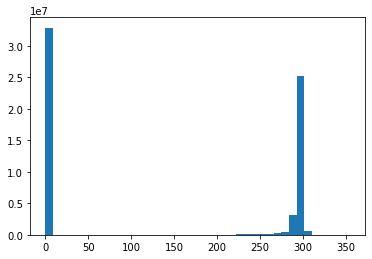

In [7]:
plt.hist(freddy_eco.flatten(), density=False, bins=40)

In [189]:
from rasterio.warp import calculate_default_transform, reproject, Resampling

dst_crs = 'EPSG:4326'

with rasterio.open('ecostress_data/ecostress_data/output/ECOSTRESS_L2_CLOUD_04951_011_20190521T075459_0601_03_CloudMask_UTM.tif') as src:
    transform, width, height = calculate_default_transform(
        src.crs, dst_crs, src.width, src.height, *src.bounds)
    kwargs = src.meta.copy()
    kwargs.update({
        'crs': dst_crs,
        'transform': transform,
        'width': width,
        'height': height
    })

    with rasterio.open('ecostress_data/ecostress_data/output/ECOSTRESS_L2_CLOUD_04951_011_20190521T075459_0601_03_CloudMask_WGS.tif', 'w', **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(
                source=rasterio.band(src, i),
                destination=rasterio.band(dst, i),
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs=dst_crs,
                resampling=Resampling.nearest)

In [2]:
import rioxarray
#es_da = rioxarray.open_rasterio("ecostress_data/ecostress_data/output/ECOSTRESS_L2_LSTE_12773_006_20201006T163238_0601_01_LST_UTM.tif")
es_da = rioxarray.open_rasterio("ecostress_data/ecostress_data/output/ECOSTRESS_L2_LSTE_04951_011_20190521T075459_0601_03_LST_WGS.tif")
es_da

<xarray.DataArray (band: 1, y: 7498, x: 8421)>
[63140658 values with dtype=float64]
Coordinates:
  * band         (band) int64 1
  * y            (y) float64 37.29 37.29 37.29 37.29 ... 32.08 32.08 32.08 32.08
  * x            (x) float64 -78.82 -78.82 -78.82 ... -72.96 -72.96 -72.96
    spatial_ref  int64 0
Attributes:
    _FillValue:    0.0
    scale_factor:  1.0
    add_offset:    0.0
    grid_mapping:  spatial_ref

In [190]:
es_da_cloud = rioxarray.open_rasterio("ecostress_data/ecostress_data/output/ECOSTRESS_L2_CLOUD_04951_011_20190521T075459_0601_03_CloudMask_WGS.tif")
es_da_cloud

<xarray.DataArray (band: 1, y: 7498, x: 8421)>
[63140658 values with dtype=uint8]
Coordinates:
  * band         (band) int64 1
  * y            (y) float64 37.29 37.29 37.29 37.29 ... 32.08 32.08 32.08 32.08
  * x            (x) float64 -78.82 -78.82 -78.82 ... -72.96 -72.96 -72.96
    spatial_ref  int64 0
Attributes:
    _FillValue:    255.0
    scale_factor:  1.0
    add_offset:    0.0
    grid_mapping:  spatial_ref

In [8]:
es_da = es_da[0]

In [10]:
es_da[es_da_cloud!=33] = np.nan

NameError: name 'es_da_cloud' is not defined

In [15]:
es_da

<xarray.DataArray (y: 7498, x: 8421)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
    band         int64 1
  * y            (y) float64 37.29 37.29 37.29 37.29 ... 32.08 32.08 32.08 32.08
  * x            (x) float64 -78.82 -78.82 -78.82 ... -72.96 -72.96 -72.96
    spatial_ref  int64 0
Attributes:
    _FillValue:    0.0
    scale_factor:  1.0
    add_offset:    0.0
    grid_mapping:  spatial_ref

In [12]:
es_da.values[es_da.values<296.65] = np.nan

In [19]:
sst_ds = xr.open_zarr('chla_zarr_sst_2019')
sst_ds

,Array,Chunk
Bytes,139.01 kB,768 B
Shape,"(181, 3, 256)","(1, 3, 256)"
Count,182 Tasks,181 Chunks
Type,int8,numpy.ndarray
,Array,Chunk
Bytes,183.49 MB,1.01 MB
Shape,"(181, 528, 480)","(1, 528, 480)"
Count,182 Tasks,181 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


In [20]:
sst_ds.sst[140].hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline=True, 
    frame_width=500, frame_height=300, clim=(25, 30), datashade=True)

:DynamicMap   []
   :Overlay
      .RGB.I       :RGB   [lon,lat]   (R,G,B,A)
      .Coastline.I :Feature   [Longitude,Latitude]

In [22]:
proj = crs.Orthographic(-90, 30)

es_da.hvplot.quadmesh(
    'x', 'y', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline=True, 
    frame_width=500, frame_height=400, datashade=True) + sst_ds.sst[140].hvplot.quadmesh(
    'lon', 'lat', projection=proj, project=True,
    cmap='inferno', dynamic=True, coastline=True, 
    frame_width=500, frame_height=400, clim=(25, 30), datashade=True)

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [x,y]   (R,G,B,A)
         .Coastline.I :Feature   [Longitude,Latitude]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .RGB.I       :RGB   [lon,lat]   (R,G,B,A)
         .Coastline.I :Feature   [Longitude,Latitude]

In [191]:
np.unique(es_da_cloud.values)

array([  0,   1,   2,   3,  15,  23,  31,  32,  33,  34,  35,  46,  47,
        55,  63, 255], dtype=uint8)

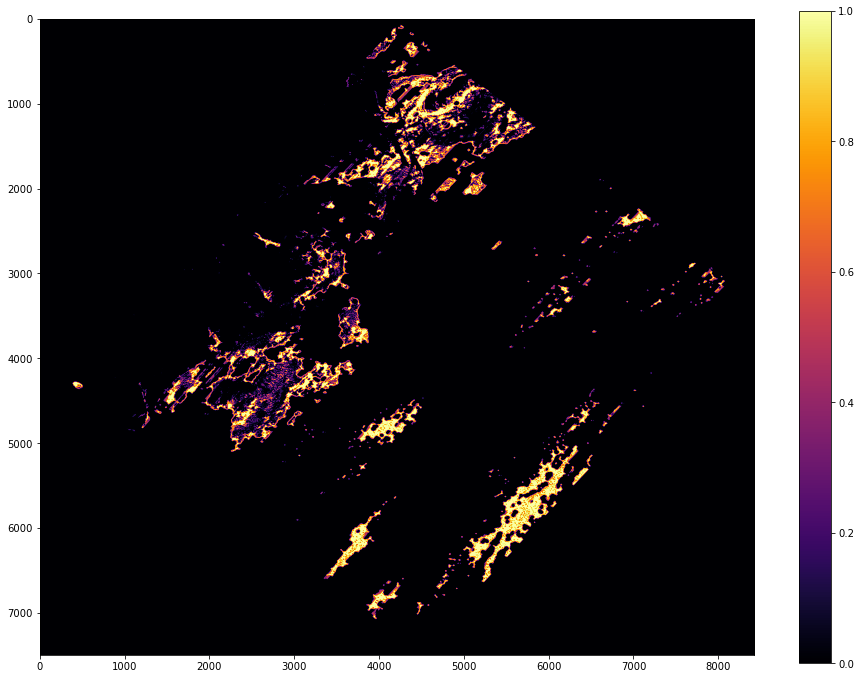

In [192]:
fig,ax = plt.subplots(figsize=(16,12))
im = ax.imshow(es_da_cloud.values[0]==35, cmap='inferno')
fig.colorbar(im)

In [195]:
es_da[0].values

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

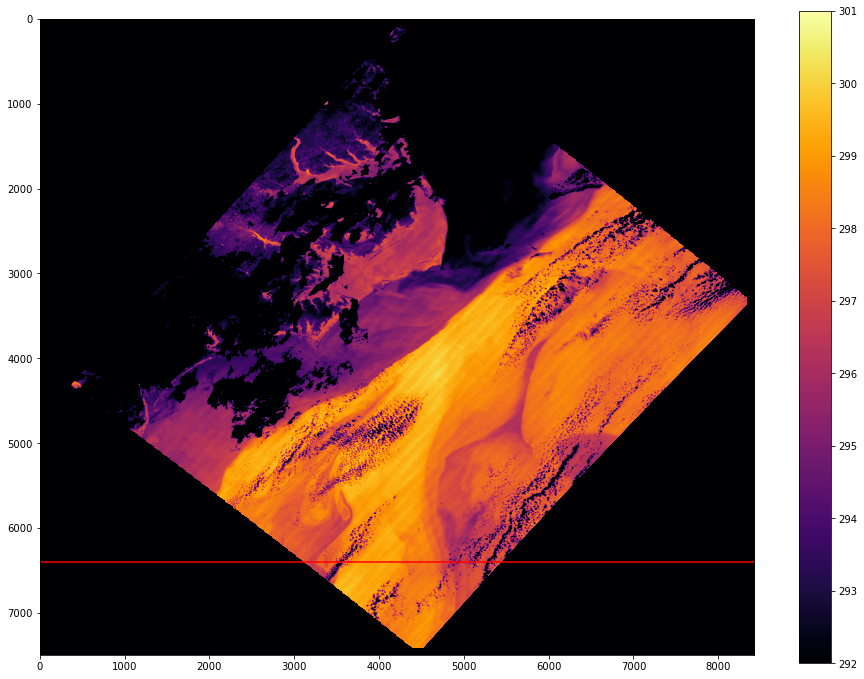

In [196]:
fig,ax = plt.subplots(figsize=(16,12))
im = ax.imshow(es_da.values[0], vmin=292, vmax=301, cmap='inferno')
ax.axhline(y=6400, color='r', linestyle='-')
fig.colorbar(im)

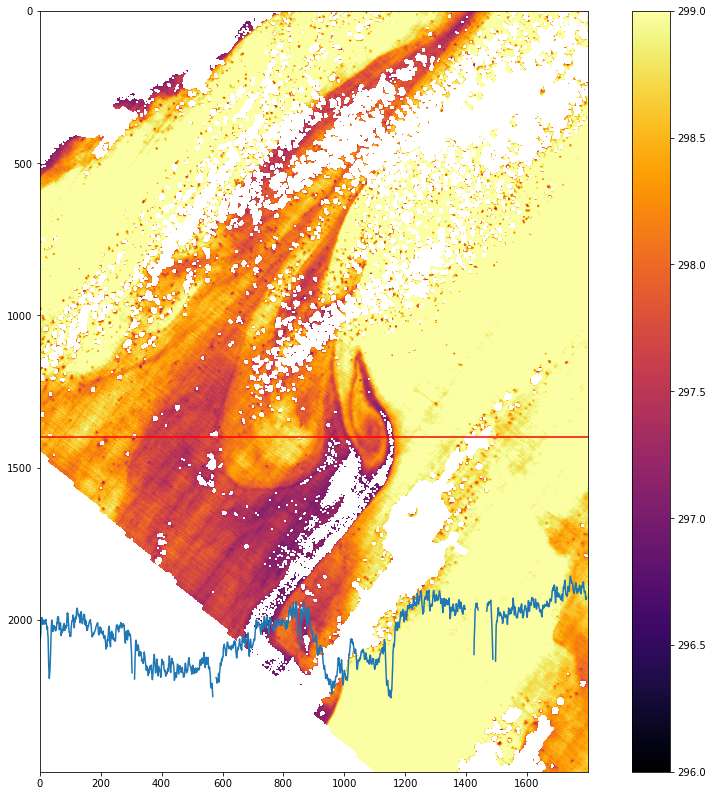

In [181]:
fig,ax = plt.subplots(figsize=(16,14))
im = ax.imshow(es_da.values[0,5000:7500,2000:3800], vmin=296, vmax=299, cmap='inferno')
ax.axhline(y=1400, color='r', linestyle='-')
#ax.plot(es_da.values[0,6400,2000:3800]*-100+32000)
N=4
ax.plot(np.convolve(es_da.values[0,6400,2000:3800]*-150+46800, np.ones((N,))/N, mode='valid'))
fig.colorbar(im)

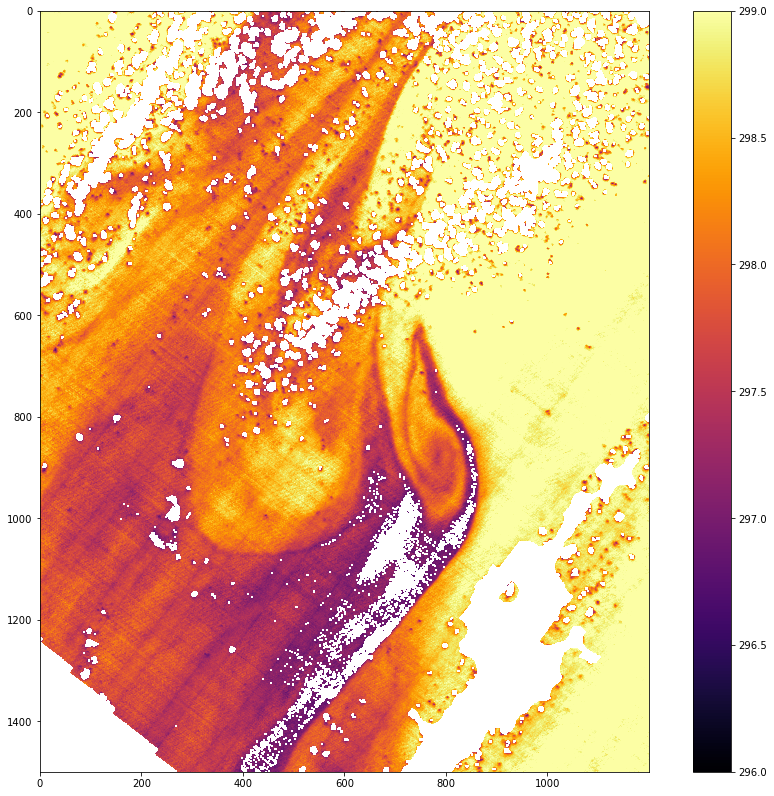

In [182]:
fig,ax = plt.subplots(figsize=(16,14))
im = ax.imshow(es_da.values[0,5500:7000,2300:3500], vmin=296, vmax=299, cmap='inferno')
#ax.axhline(y=1400, color='r', linestyle='-')
fig.colorbar(im)

array([298.26 , 298.304, 298.316, ..., 299.14 , 299.14 , 299.16 ])

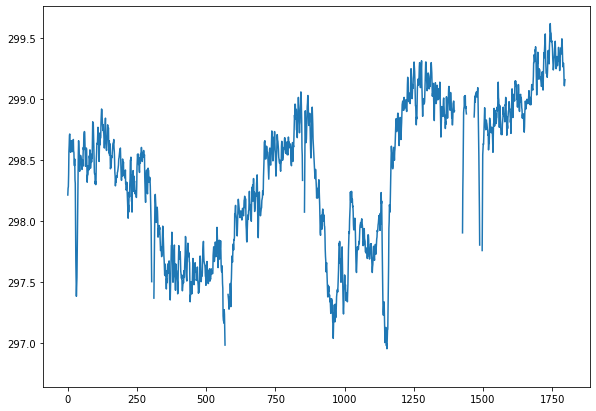

In [175]:
fig,ax = plt.subplots(figsize=(9.8,7))
#ax.plot(es_da.values[0,6400,2000:3800])
N=4
ax.plot(np.convolve(es_da.values[0,6400,2000:3800], np.ones((N,))/N, mode='valid'))

In [ ]:
fig,ax = plt.subplots(figsize=(16,12))
im = ax.imshow(es_da.values[0,5000:7500,2000:3800], vmin=292, vmax=301, cmap='inferno')
fig.colorbar(im)

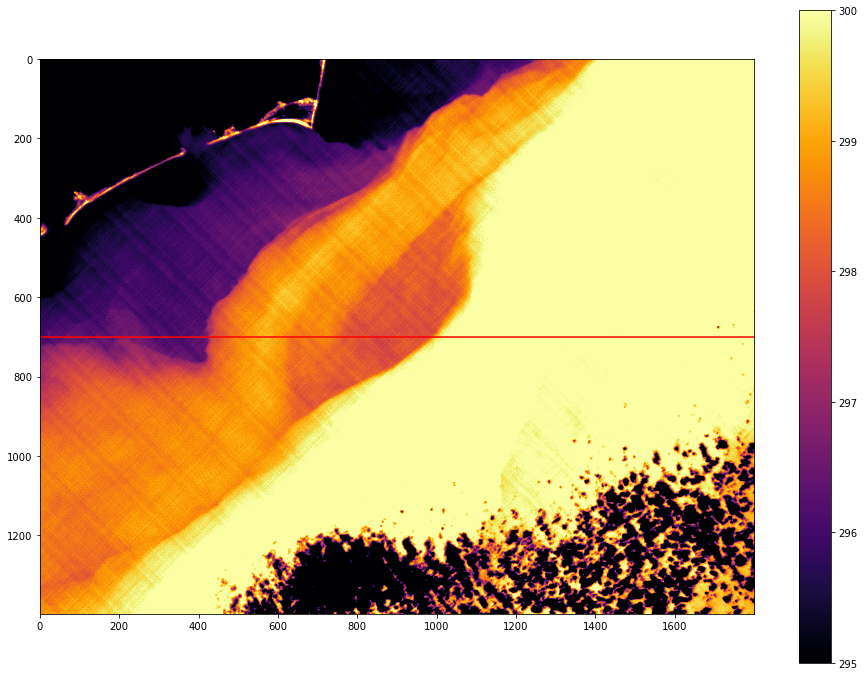

In [53]:
fig,ax = plt.subplots(figsize=(16,12))
im = ax.imshow(es_da.values[0,3000:4400,2000:3800], vmin=295, vmax=300, cmap='inferno')
ax.axhline(y=700, color='r', linestyle='-')

fig.colorbar(im)

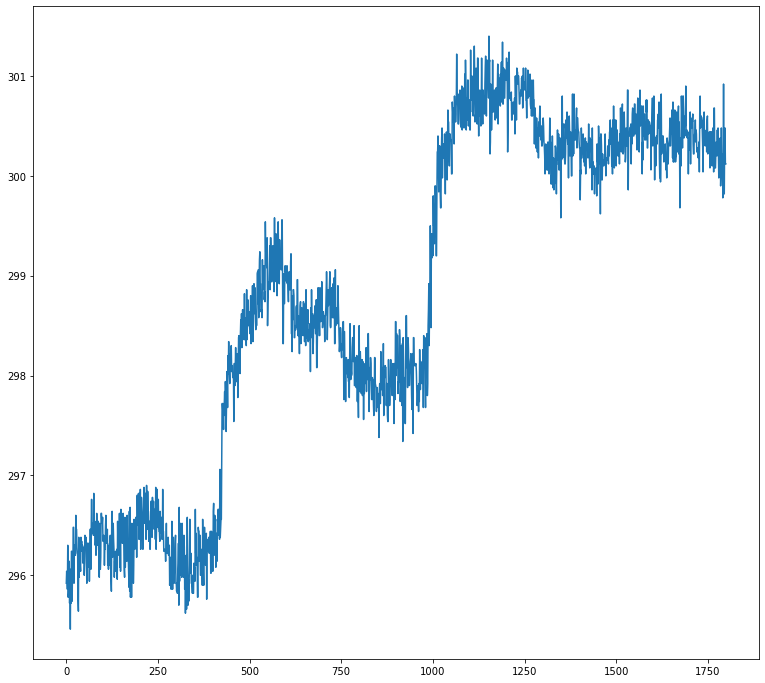

In [52]:
fig,ax = plt.subplots(figsize=(13,12))
ax.plot(es_da.values[0,3700,2000:3800])

In [ ]:
fig,ax = plt.subplots(figsize=(16,12))
im = ax.imshow(es_da.values[0,3000:4400,2000:3800], vmin=295, vmax=300, cmap='inferno')
fig.colorbar(im)

In [ ]:
np.convolve(x, np.ones((N,))/N, mode='valid')